
# 드라이브 연결

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
cd /content/drive/MyDrive/Optimizing_traffic_lights_project/total_dataset/for_preprocessing

[Errno 2] No such file or directory: '/content/drive/MyDrive/Optimizing_traffic_lights_project/total_dataset/for_preprocessing'
/content


In [ ]:
!pwd

/content


In [ ]:
!ls

drive  sample_data


In [ ]:
import os
import json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
from tqdm import tqdm
from PIL import Image

# 사람이 존재하는 이미지 및 개수 파악

In [ ]:
image_id_with_human=[]

def read_json_files_in_directories(root_directory):
    for dirpath, dirnames, filenames in os.walk(root_directory):
        for filename in filenames:
            if filename.endswith('.json'):
                json_file_path = os.path.join(dirpath, filename)
                with open(json_file_path, 'r') as json_file:
                    try:
                        data = json.load(json_file)
                        # 이 부분에 필요한 기능 입력
                        for i in data["annotations"]:
                          if 7 in i['category_id']:
                            image_id_with_human.append(i["image_id"])
                    except json.JSONDecodeError as e:
                        print(f'Error decoding JSON in file {json_file_path}: {str(e)}')

# 예시로 현재 디렉터리를 기준으로 JSON 파일을 읽어옵니다.
current_directory = os.getcwd()
read_json_files_in_directories(current_directory)

KeyError: ignored

In [ ]:
print(image_id_with_human)

[]


In [ ]:
print(len(image_id_with_human))

0


In [ ]:
image_filename_with_human=[]

In [ ]:
from collections import defaultdict
image_cnt_per_folder = defaultdict(list)

def read_json_files_in_directories(root_directory):
    for dirpath, dirnames, filenames in os.walk(root_directory):
        for filename in filenames:
            if filename.endswith('.json'):
                json_file_path = os.path.join(dirpath, filename)
                with open(json_file_path, 'r') as json_file:
                    try:
                        data = json.load(json_file)
                        # 이 부분에 필요한 기능 입력
                        l = dirpath.split('/')[-2:]
                        location = l[0]
                        folder = l[1]

                        for i in data["images"]:
                          if i["id"] in image_id_with_human:
                            image_cnt_per_folder[(location, folder)].append(i["file_name"])
                            image_filename_with_human.append(i["file_name"])
                    except json.JSONDecodeError as e:
                        print(f'Error decoding JSON in file {json_file_path}: {str(e)}')

# 예시로 현재 디렉터리를 기준으로 JSON 파일을 읽어옵니다.
current_directory = os.getcwd()
read_json_files_in_directories(current_directory)

KeyError: ignored

In [ ]:
print(image_filename_with_human)
print(len(image_filename_with_human))

In [ ]:
# dict={"계룡대교네거리":{"SC580":}}
print(image_cnt_per_folder)

In [ ]:
for a,b in image_cnt_per_folder.items():
    print(a,len(b))

# JSON 수정 및 바운딩 박스 파악

In [ ]:
# json 파일 경로와 파일 이름 // 이미지 경로 설정(이미지 경로는 장소 디렉터리까지만, 카메라는 X)
json_dirpath='/content/drive/MyDrive/Optimizing_traffic_lights_project/total_dataset/labeling_data/training/교통안전(Bbox)/연구단지네거리/SC0004601' # json 파일 디렉터리 설정
json_filename='연구단지네거리_SC0004601.json' # json 파일 이름 설정
img_dirpath='/content/drive/MyDrive/Optimizing_traffic_lights_project/total_dataset/image_data/training/교통안전(Bbox)/연구단지네거리' # 이미지 디렉터리 설정

In [ ]:
# json 파일 읽기
json_file_path = os.path.join(json_dirpath, json_filename)
with open(json_file_path, 'r') as json_file:
  data = json.load(json_file)

print(f"이미지 개수: {len(data['images'])}장")

이미지 개수: 802장


In [ ]:
# 사람 없는 이미지는 json에서 제거
modified_images, modified_annotations=[],[]

for image, annotation in zip(data['images'], data['annotations']):
  if 7 in annotation["category_id"]:
    modified_images.append(image)
    modified_annotations.append(annotation)

print(f"사람 있는 이미지 개수: {len(modified_images)}장")

data['images']=modified_images
data['annotations']=modified_annotations

사람 있는 이미지 개수: 300장


In [ ]:
# annotation에 is_moving과 direction 추가 (값들은 전부 0으로 초기화했음)
for annotation in data["annotations"]:
  annotation['is_moving']=[0]*len(annotation['category_id'])
  annotation['direction']=[0]*len(annotation['category_id'])

In [ ]:
# 새로운 JSON 파일에 데이터 저장
json_filename = "new_" + json_filename  # 새로운 파일명 설정
new_json_file_path = os.path.join(json_dirpath, json_filename)

with open(new_json_file_path, 'w') as new_json_file:
    json.dump(data, new_json_file, indent=4)

print(f"Data from '{json_filename}' saved to '{json_filename}'.")

Data from 'new_연구단지네거리_SC0004601.json' saved to 'new_연구단지네거리_SC0004601.json'.


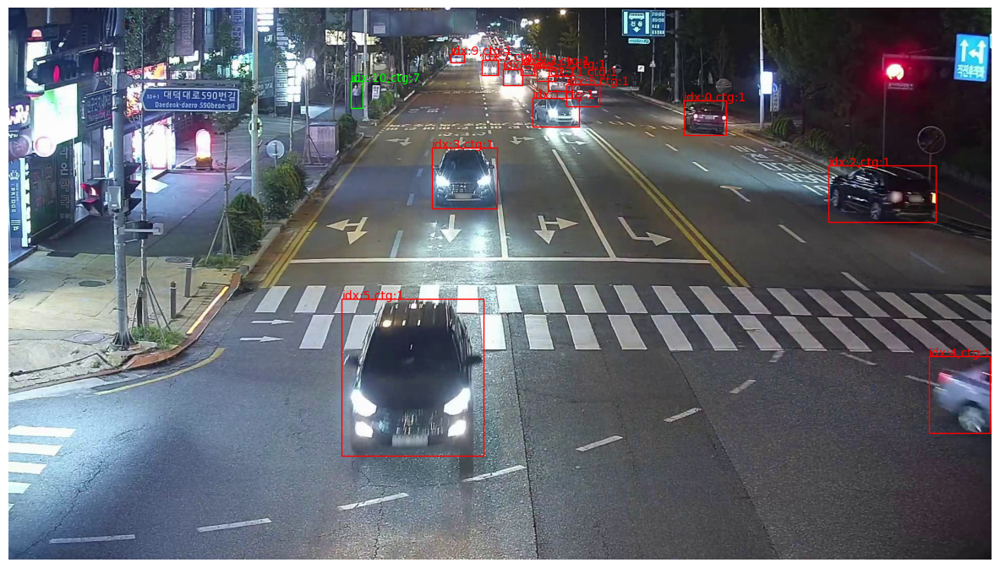

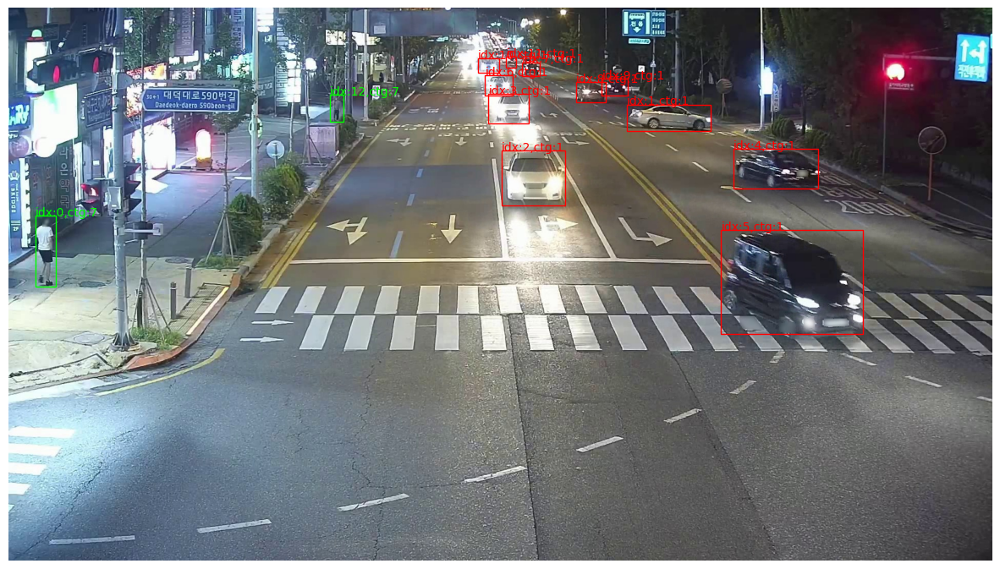

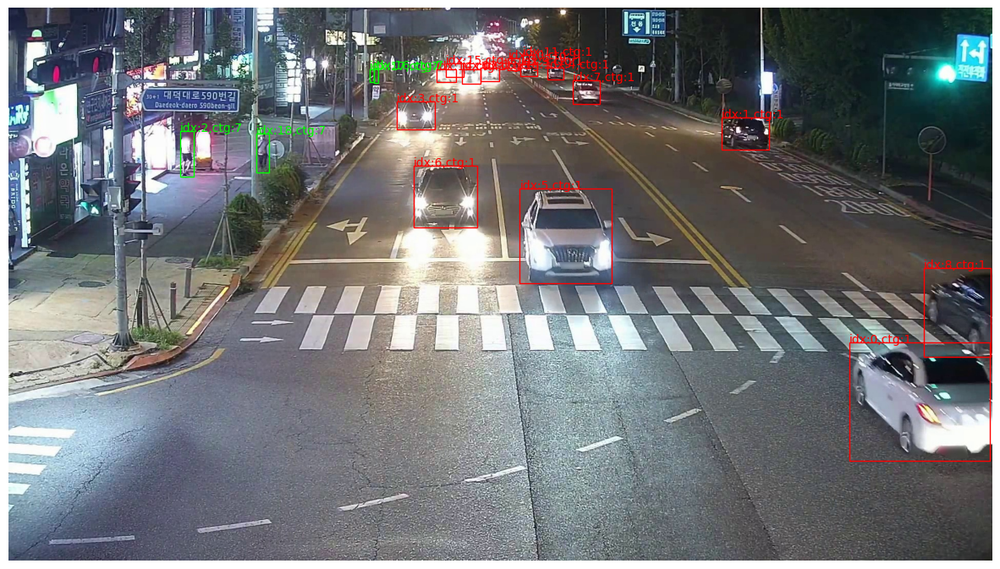

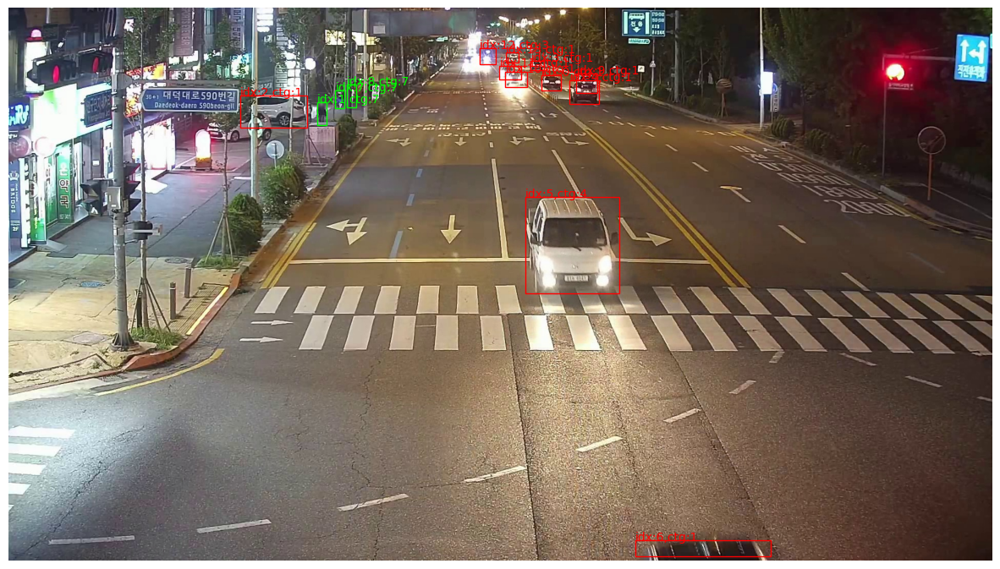

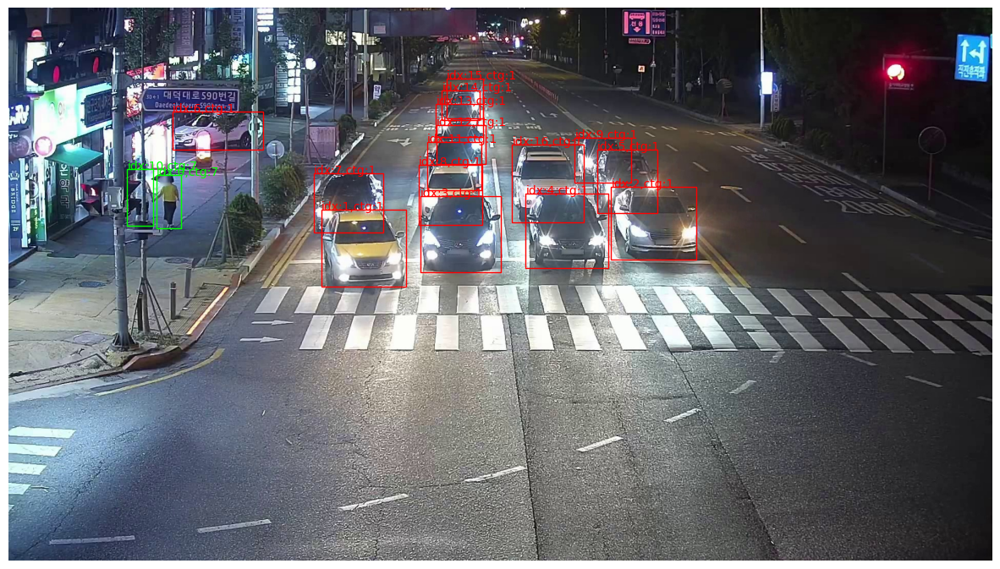

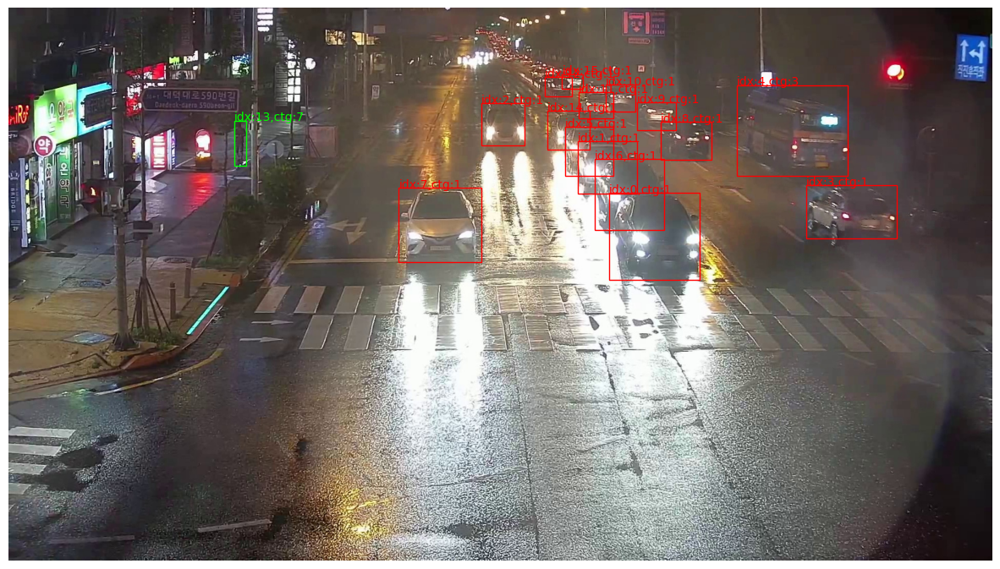

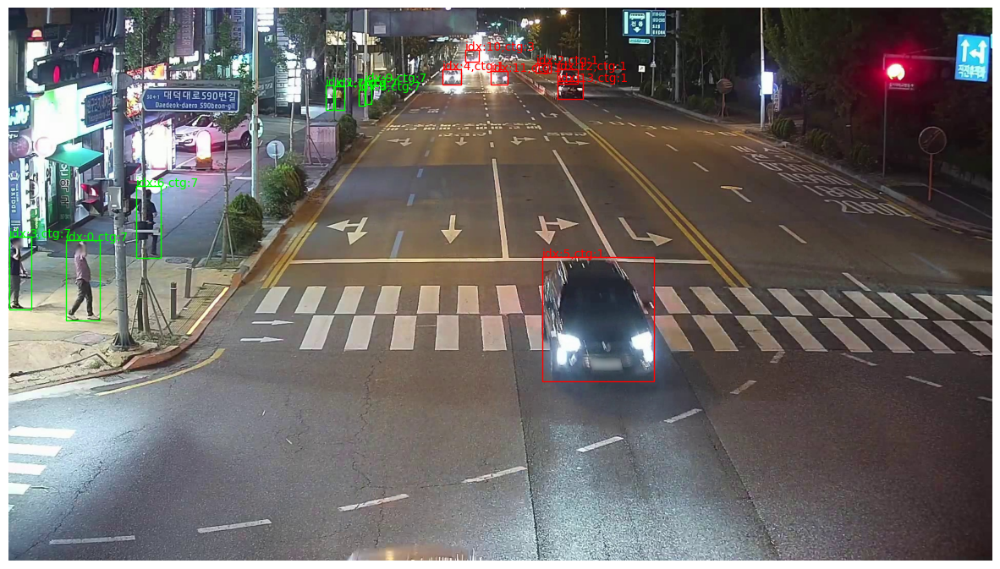

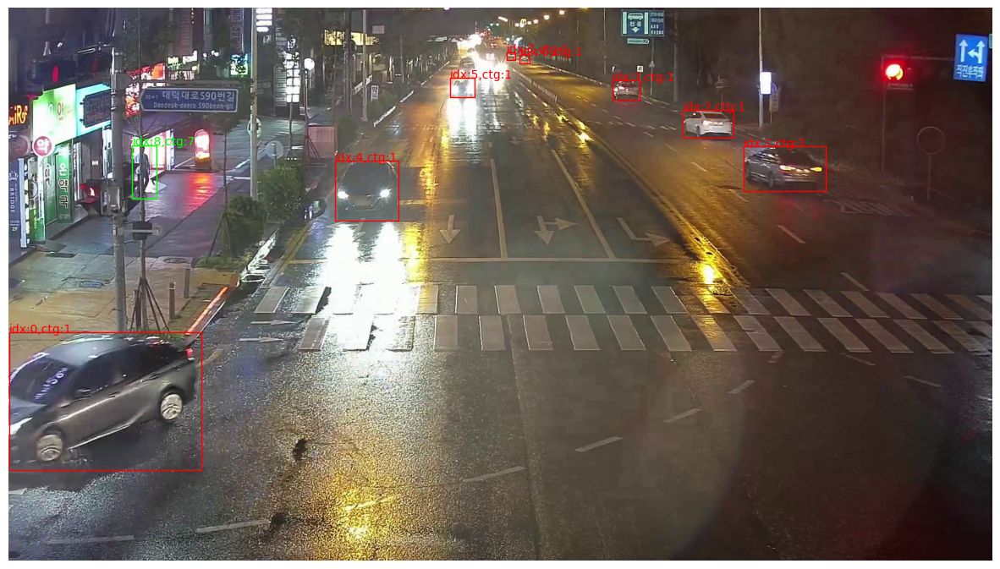

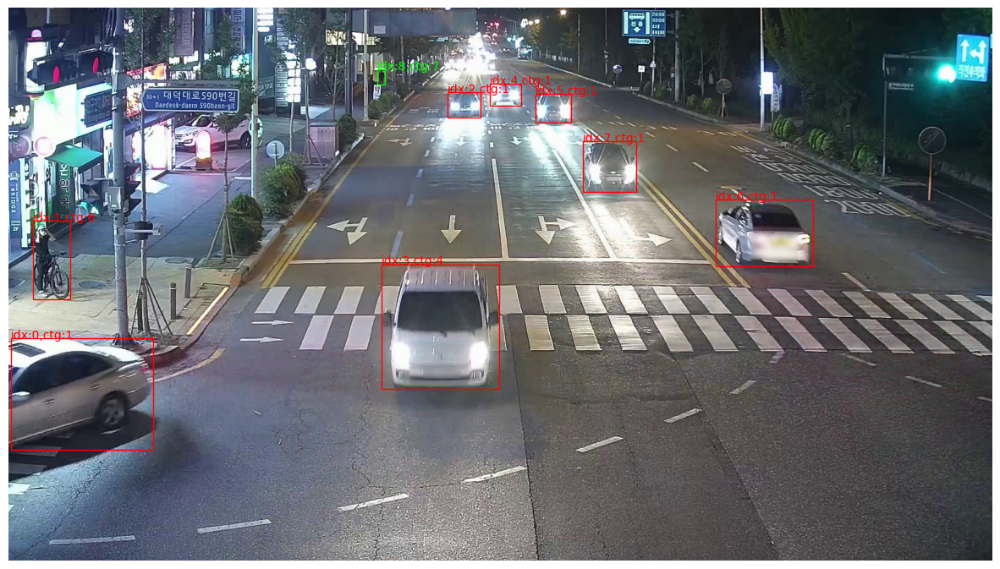

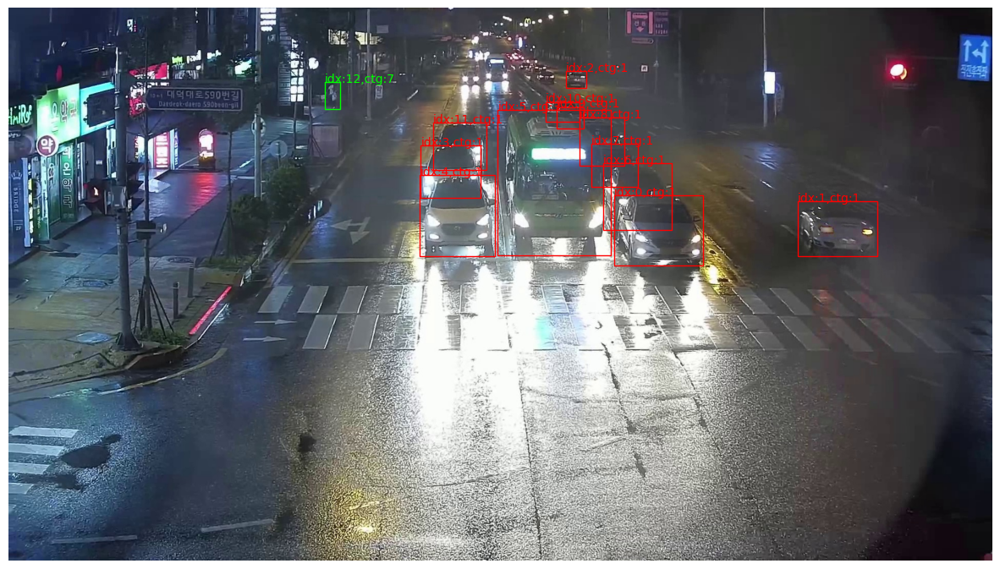

In [ ]:
# json 파일에서 annotation 데이터(bbox데이터) 받아오기
def parse_json(json_data):
    bbox = json_data.get('bbox', [])
    category_ids = json_data.get('category_id', [])
    image_id = json_data.get('image_id', None)
    return bbox, category_ids, image_id

# bbox 표시
def display_bounding_boxes(image_path, bbox, category_ids):
    # Load the image
    img = plt.imread(image_path)

    # Create a new figure and set its size
    fig = plt.figure(figsize=(15, 15)) # 이미지 더 크게 보려면 여기 숫자 크기를 늘리세요.

    # Display the image
    plt.imshow(img)

    # Create a plot object
    ax = plt.gca()

    # Plot each bounding box
    for i, box in enumerate(bbox):
        x, y, w, h = box
        if category_ids[i]==7: # 사람이면 연두색으로 표시
          rect = patches.Rectangle((x, y), w - x, h - y, linewidth=1, edgecolor='lime', facecolor='none', label=f'category: {category_ids[i]}, idx: {i}')
          ax.add_patch(rect)
          ax.text(x, y, f'idx:{i},ctg:{category_ids[i]}', color='lime', fontsize=10, alpha=1)
        else:
          rect = patches.Rectangle((x, y), w - x, h - y, linewidth=1, edgecolor='red', facecolor='none', label=f'category: {category_ids[i]}, idx: {i}')
          ax.add_patch(rect)
          ax.text(x, y, f'idx:{i},ctg:{category_ids[i]}', color='red', fontsize=10, alpha=1)

    plt.axis('off')  # Hide axis labels and ticks
    plt.show()

# 이미지들에서 bbox 표시 (범위 설정해주세요. 모든 이미지 하면 시간 엄청 오래 걸림)
for image in data["images"][10:20]:
    bbox_info= [i for i in data["annotations"] if i["image_id"]==image["id"]][0]
    bbox, category_ids, _ = parse_json(bbox_info)
    # if not 7 in category_ids: # 사진에 사람이 없으면 건너뜀
    #   print(f"{image['file_name']}에 사람이 존재하지 않습니다!")
    #   continue
    image_path = os.path.join(img_dirpath, image['file_name'])
    display_bounding_boxes(image_path, bbox, category_ids)

# 차선 화살표 바운딩 박스 추가

In [ ]:
# json 파일 경로와 파일 이름 // 이미지 경로 설정(이미지 경로는 장소 디렉터리까지만, 카메라는 X)
json_dirpath='/content/drive/MyDrive/labeling_data__교통안전(Bbox)_바로가기/연구단지네거리/SC0004603/' # json 파일 디렉터리 설정
json_filename='modified_direction_연구단지네거리_SC0004603.json' # json 파일 이름 설정
img_dirpath='/content/drive/MyDrive/Optimizing_traffic_lights_project/total_dataset/image_data/training/교통안전(Bbox)/연구단지네거리' # 이미지 디렉터리 설정

In [ ]:
# json 파일 읽기
json_file_path = os.path.join(json_dirpath, json_filename)
print(json_file_path)
with open(json_file_path, 'r') as json_file:
  data = json.load(json_file)

print(f"이미지 개수: {len(data['images'])}장")

/content/drive/MyDrive/labeling_data__교통안전(Bbox)_바로가기/연구단지네거리/SC0004603/modified_direction_연구단지네거리_SC0004603.json
이미지 개수: 445장


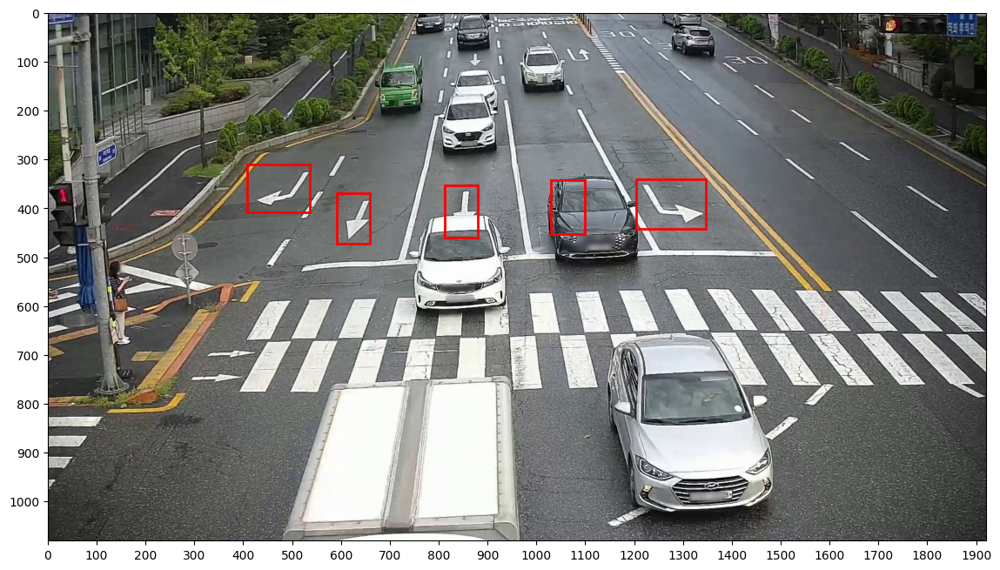

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# 이미지 경로 생성
image_filename = data["images"][1]['file_name']
img_path = os.path.join(img_dirpath, image_filename)

# 이미지 읽기
img = plt.imread(img_path)

# 이미지 크기 가져오기
img_height, img_width, _ = img.shape

# 이미지 크기 설정
fig, ax = plt.subplots(figsize=(14, 14 * img_height / img_width))

# 바운딩 박스를 표시할 좌표 2개 (왼쪽 위, 오른쪽 아래)
bbox_points_list = [
    ((408, 310),(536, 408))
,((591,368),(660,473))
,((812,352),(881,460))
,((1029,343),(1100,453))
,((1204,340),(1346,441))
] # (top_left ,bottom_right)

# 바운딩 박스 생성
for bbox_point in bbox_points_list:
  top_left = bbox_point[0]
  bottom_right = bbox_point[1]
  bbox = patches.Rectangle(top_left, bottom_right[0] - top_left[0], bottom_right[1] - top_left[1], linewidth=2, edgecolor='r', facecolor='none')
  ax.add_patch(bbox)

# 이미지를 그래프에 추가
ax.imshow(img, origin='lower', extent=[0, img_width, 0, img_height])  # origin 값을 'lower'로 변경

# x축, y축 눈금 설정 (단위: 100)
ax.set_xticks([100 * i for i in range(int(img_width / 100) + 1)])

# y-축 눈금을 거꾸로 설정
y_ticks = [100 * i for i in range(int(img_height / 100), -1, -1)]
ax.set_yticks(y_ticks)

# 바운딩 박스와 이미지의 좌표 설정에 따라 축 범위 설정
ax.set_xlim(0, img_width)
ax.set_ylim(img_height, 0)

# 그래프 보이기
plt.show()


In [ ]:
for i in bbox_points_list:
  points=[]
  points.append(i[0][0])
  points.append(i[0][1])
  points.append(i[1][0])
  points.append(i[1][1])

  for j in range(len(data['annotations'])):
    data['annotations'][j]['bbox'].append(points)

In [ ]:
for j in range(len(data['annotations'])):
    data['annotations'][j]['direction']+=[10, 8, 8, 8,9]

In [ ]:
# 새로운 JSON 파일에 데이터 저장
json_filename = "arrow_" + json_filename  # 새로운 파일명 설정
new_json_file_path = os.path.join(json_dirpath, json_filename)

with open(new_json_file_path, 'w') as new_json_file:
    json.dump(data, new_json_file, indent=4)

print(f"Data from '{json_filename}' saved to '{json_filename}'.")

Data from 'arrow_modified_direction_연구단지네거리_SC0004603.json' saved to 'arrow_modified_direction_연구단지네거리_SC0004603.json'.


# road bbox에 따른 차량 방향 체크 프로그램 실행은 여기서부터

In [ ]:
# json 파일 경로와 파일 이름 // 이미지 경로 설정(이미지 경로는 장소 디렉터리까지만, 카메라는 X)
json_dirpath='/content/drive/MyDrive/Optimizing_traffic_lights_project/total_dataset/labeling_data/training/교통안전(Bbox)/충대오거리/SC0028805/' # json 파일 디렉터리 설정
json_filename='modified_충대오거리_SC0028805.json' # json 파일 이름 설정
img_dirpath='/content/drive/MyDrive/Optimizing_traffic_lights_project/total_dataset/image_data/training/교통안전(Bbox)/충대오거리' # 이미지 디렉터리 설정

In [ ]:
# json 파일 읽기
json_file_path = os.path.join(json_dirpath, json_filename)
print(json_file_path)
with open(json_file_path, 'r') as json_file:
  data = json.load(json_file)

print(f"이미지 개수: {len(data['images'])}장")

/content/drive/MyDrive/Optimizing_traffic_lights_project/total_dataset/labeling_data/training/교통안전(Bbox)/충대오거리/SC0028805/modified_충대오거리_SC0028805.json


FileNotFoundError: ignored

In [ ]:
# 사람 없는 이미지는 json에서 제거
modified_images, modified_annotations=[],[]

for image, annotation in zip(data['images'], data['annotations']):
  if 7 in annotation["category_id"]:
    modified_images.append(image)
    modified_annotations.append(annotation)

print(f"사람 없는 이미지 개수: {len(modified_images)}장")

data['images']=modified_images
data['annotations']=modified_annotations

사람 없는 이미지 개수: 134장


In [ ]:
# annotation에 is_moving과 direction 추가 (값들은 전부 0으로 초기화했음)
for annotation in data["annotations"]:
  annotation['is_moving']=[0]*len(annotation['category_id'])
  annotation['direction']=[0]*len(annotation['category_id'])

In [ ]:
from shapely.geometry import Polygon

def resize_quad(quad, original_img_shape, resized_img_shape):
    orig_width, orig_height = original_img_shape[1], original_img_shape[0]
    new_width, new_height = resized_img_shape[1], resized_img_shape[0]

    resized_quad = []
    for x, y in quad:
        x_new = (x / orig_width) * new_width
        y_new = (y / orig_height) * new_height
        resized_quad.append((x_new, y_new))

    return resized_quad

def get_car_quad(car_bbox):
    car_x1, car_y1 = car_bbox[0], car_bbox[1]
    car_x2, car_y2 = car_bbox[2], car_bbox[3]
    car_bbox_lu = [car_x1, car_y1]
    car_bbox_ld = [car_x1, car_y2]
    car_bbox_rd = [car_x2, car_y2]
    car_bbox_ru = [car_x2, car_y1]
    return [car_bbox_lu, car_bbox_ld, car_bbox_rd, car_bbox_ru]

def check_in_road(road_quad, car_quad, percent=90):
    poly1 = Polygon(road_quad)
    poly2 = Polygon(car_quad)
    intersection = poly2.intersection(poly1)
    return intersection.area >= poly2.area * percent / 100

# def checking_bounding_boxes(image_path, quads, colors):
#     img = plt.imread(image_path)
#     fig = plt.figure(figsize=(15, 15))
#     plt.imshow(img)
#     ax = plt.gca()
#     idx = 0
#     for quad, color in zip(quads, colors):
#         quad = resize_quad(quad, FIRST_IMG_SIZE, img.shape)
#         polygon = patches.Polygon(quad, linewidth=1, edgecolor=color, facecolor='none')
#         ax.add_patch(polygon)
#         quads[idx] = quad
#         idx += 1
#     plt.axis('off')
#     plt.show()

# json 파일에서 annotation 데이터(bbox데이터) 받아오기
def parse_json(json_data):
    bbox = json_data.get('bbox', [])
    category_ids = json_data.get('category_id', [])
    image_id = json_data.get('image_id', None)
    return bbox, category_ids, image_id

def display_bounding_boxes(image_path, quads, category_ids, annotation_id, is_show):
    img = plt.imread(image_path)
    direction=0
    if is_show:
        fig = plt.figure(figsize=(15, 15))
        plt.imshow(img)
        ax = plt.gca()

    for i, quad in enumerate(quads):
        car_quad = get_car_quad(quad)

        if category_ids[i] in [6,7]:  # 사람이면 연두색으로 표시
            idx = 0
            for road_bbox in ALL[5:]:
                road_bbox = resize_quad(road_bbox, FIRST_IMG_SIZE, img.shape)

                if check_in_road(road_bbox, car_quad, 60):
                    data["annotations"][annotation_id]['direction'][i] = [6,6,7][idx]
                    break
                idx += 1
            if is_show:
                polygon = patches.Polygon(car_quad, linewidth=1, edgecolor='lime', facecolor='none')
                ax.add_patch(polygon)
                print(annotation_id, i,data['annotations'][annotation_id]['direction'])
                ax.text(car_quad[0][0], car_quad[0][1],
                    f"{i},{category_ids[i]},{data['annotations'][annotation_id]['direction'][i]}",
                    color='lime', fontsize=20, alpha=1, weight='bold')

        if category_ids[i] != 7 and  data["annotations"][annotation_id]['direction'][i] == 0:
            direction = 1
            for road_bbox in ALL[:5]:
                road_bbox = resize_quad(road_bbox, FIRST_IMG_SIZE, img.shape)
                if check_in_road(road_bbox, car_quad, [50,50,50,50,50][direction-1]):
                    data["annotations"][annotation_id]['direction'][i] = direction
                    break
                direction += 1
            if is_show:
                polygon = patches.Polygon(car_quad, linewidth=1, edgecolor='lime', facecolor='none')
                ax.add_patch(polygon)
                ax.text(car_quad[0][0], car_quad[0][1],
                    f"{i},{category_ids[i]},{data['annotations'][annotation_id]['direction'][i]}",
                    color='lime', fontsize=20, alpha=1, weight='bold')

    if is_show:
        plt.axis('off')
        plt.show()

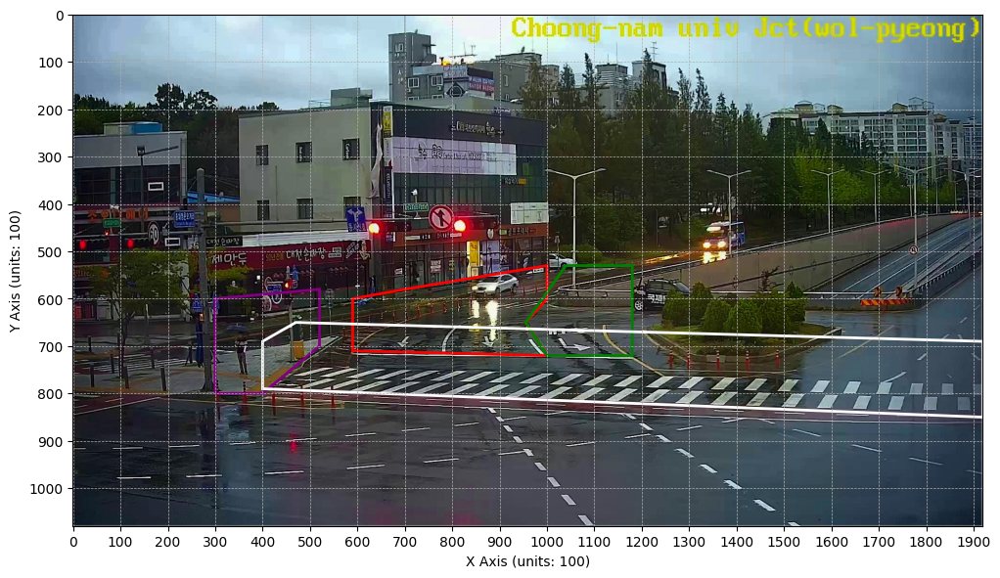

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.patches as patches

NOT_FIRST = 11

FIRST_IMG_SIZE = plt.imread(os.path.join(img_dirpath, data["images"][1]['file_name'])).shape

def checking_bounding_boxes(image_path, quads, colors):
    # Load the image
    image = plt.imread(image_path)

    # Create figure and axis
    fig, ax = plt.subplots(1, figsize=(12, 12))

    # Display the image
    ax.imshow(image)

    # Plot bounding boxes
    for quad, color in zip(quads, colors):
        poly = patches.Polygon(quad, linewidth=2, edgecolor=color, facecolor='none')
        ax.add_patch(poly)

    # Set axis labels
    ax.set_xlabel('X Axis (units: 100)')
    ax.set_ylabel('Y Axis (units: 100)')

    # Set custom ticks at intervals of 100 units
    ax.set_xticks(range(0, FIRST_IMG_SIZE[1] + 1, 100))
    ax.set_yticks(range(0, FIRST_IMG_SIZE[0] + 1, 100))

    # Add grid with dashed lines
    ax.grid(which='both', linestyle='--', linewidth=0.5)

    # Show the plot
    plt.show()

######################################################################################################
# road_quad 표시 [(좌상, 좌하, 우하, 우상)] 좌표값을 입력
straight_road_quad = [(590, 710), (1000, 720), (955, 650), (1000, 600),(1000, 530),(700,580),(590,600)]     # 직진 = 1
left_road_quad = [(1000, 720), (1180, 720), (1180, 620), (1180, 530),(1040,530),(955, 650)]        # 좌회전 = 2
right_road_quad = [(0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]                           # 우회전 = 3
straight_left_road_quad = [(0, 0), (0, 0), (0, 0), (0, 0)]   # 직좌 = 4
straight_right_road_quad = [(0, 0), (0, 0), (0, 0), (0, 0)]   # 직우 = 5
wait_pedestrian_left = [(300,600),(300, 800), (400, 800), (520, 700), (520, 580)]       # 왼쪽에서 대기 중인 보행자 = 6
wait_pedestrian_right = [(0, 0), (0, 0), (0, 0), (0, 0)]                 # 오른쪽에서 대기 중인 보행자 = 6
walking_pedestrian = [(400, 790), (1920, 850), (1920, 690), (470, 650),(400,690)]     # 신호 건너는중 중인 보행자 = 7
######################################################################################################

ALL = [straight_road_quad, left_road_quad, right_road_quad,straight_left_road_quad,straight_right_road_quad, wait_pedestrian_left, wait_pedestrian_right, walking_pedestrian]
all_color = ['red', 'green', 'blue','yellow','orange', 'purple', 'purple', 'white']
checking_bounding_boxes(os.path.join(img_dirpath, data["images"][5]['file_name']), ALL, all_color)

In [ ]:
# 이미지마다 차량 보행자 방향 탐색
for idx, image in enumerate(data["images"]):
    bbox_info= [i for i in data["annotations"] if i["image_id"]==image["id"]][0]
    bbox, category_ids, _ = parse_json(bbox_info)
    image_path = os.path.join(img_dirpath, image['file_name'])
    display_bounding_boxes(image_path, bbox, category_ids, idx, is_show = False)

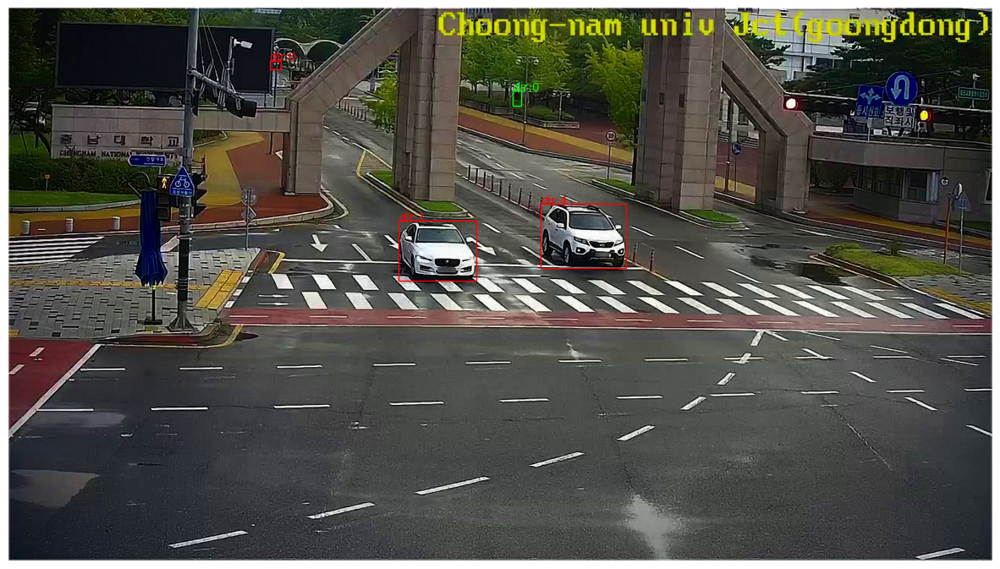

In [ ]:
### 방향 설정 잘 됐는지 확인하기 ###

def parse_json_with_direction(json_data):
    bbox = json_data.get('bbox', [])
    category_ids = json_data.get('category_id', [])
    image_id = json_data.get('image_id', None)
    direction = json_data.get('direction', [])
    return bbox, category_ids, image_id, direction

# bbox 표시
def display_bounding_boxes_with_direction(image_path, bbox, category_ids, direction):
    # Load the image
    img = plt.imread(image_path)

    # Create a new figure and set its size
    fig = plt.figure(figsize=(15, 15)) # 이미지 더 크게 보려면 여기 숫자 크기를 늘리세요.

    # Display the image
    plt.imshow(img)

    # Create a plot object
    ax = plt.gca()

    # Plot each bounding box
    for i, box in enumerate(bbox):
        x, y, w, h = box
        if category_ids[i]==7: # 사람이면 연두색으로 표시
          rect = patches.Rectangle((x, y), w - x, h - y, linewidth=1, edgecolor='lime', facecolor='none', label=f'category: {category_ids[i]}, idx: {i}, dir: {direction[i]}')
          ax.add_patch(rect)
          ax.text(x, y, f'dir:{direction[i]}', color='lime', fontsize=10, alpha=1)
        else:
          rect = patches.Rectangle((x, y), w - x, h - y, linewidth=1, edgecolor='red', facecolor='none', label=f'category: {category_ids[i]}, idx: {i}, dir: {direction[i]}')
          ax.add_patch(rect)
          ax.text(x, y, f'dir:{direction[i]}', color='red', fontsize=10, alpha=1)
          # ax.text(x, y, f'idx:{i},ctg:{category_ids[i]},dir:{direction[i]}', color='red', fontsize=10, alpha=1)

    plt.axis('off')  # Hide axis labels and ticks
    plt.show()

# 이미지들에서 bbox 표시 (범위 설정해주세요. 모든 이미지 하면 시간 엄청 오래 걸림)
for image in data["images"][6:7]:
    bbox_info= [i for i in data["annotations"] if i["image_id"]==image["id"]][0]
    bbox, category_ids, _, direction = parse_json_with_direction(bbox_info)
    # if not 7 in category_ids: # 사진에 사람이 없으면 건너뜀
    #   print(f"{image['file_name']}에 사람이 존재하지 않습니다!")
    #   continue
    image_path = os.path.join(img_dirpath, image['file_name'])
    display_bounding_boxes_with_direction(image_path, bbox, category_ids, direction)

In [ ]:
# 유의미한 보행자 데이터 추출
modified_images, modified_annotations = [], []

for image, annotation in zip(data['images'], data['annotations']):
  for i in range(len(annotation['category_id'])):
    if annotation['category_id'][i] == 7 and annotation['direction'][i]!=0:
        modified_images.append(image)
        modified_annotations.append(annotation)
        break

print(f"사람이 있고 방향이 0이 아닌 이미지 개수: {len(modified_images)}장")

data['images'] = modified_images
data['annotations'] = modified_annotations

사람이 있고 방향이 0이 아닌 이미지 개수: 19장


In [ ]:
# 새로운 JSON 파일에 데이터 저장
json_filename = "direction_" + json_filename  # 새로운 파일명 설정
new_json_file_path = os.path.join(json_dirpath, json_filename)

with open(new_json_file_path, 'w') as new_json_file:
    json.dump(data, new_json_file, indent=4)

print(f"Data from '{json_filename}' saved to '{json_filename}'.")

Data from 'direction_충대오거리_SC002883.json' saved to 'direction_충대오거리_SC002883.json'.


# 이미지 사이즈 올바른 것만 뽑아내버리기

In [ ]:
# json 파일 경로와 파일 이름 // 이미지 경로 설정(이미지 경로는 장소 디렉터리까지만, 카메라는 X)
json_dirpath='/content/drive/MyDrive/Optimizing_traffic_lights_project/total_dataset/labeling_data/training/교통안전(Bbox)/충대오거리/SC002883/' # json 파일 디렉터리 설정
json_filename='충대오거리_SC002883.json' # json 파일 이름 설정
img_dirpath='/content/drive/MyDrive/Optimizing_traffic_lights_project/total_dataset/image_data/training/교통안전(Bbox)/충대오거리' # 이미지 디렉터리 설정

In [ ]:
# json 파일 읽기
json_file_path = os.path.join(json_dirpath, json_filename)
print(json_file_path)
with open(json_file_path, 'r') as json_file:
  data = json.load(json_file)

print(f"이미지 개수: {len(data['images'])}장")

/content/drive/MyDrive/Optimizing_traffic_lights_project/total_dataset/labeling_data/training/교통안전(Bbox)/충대오거리/SC002883/충대오거리_SC002883.json
이미지 개수: 198장


In [ ]:
modified_images=[]
modified_annotations=[]

def get_image_size(image_path):
    try:
        # 이미지 열기
        with Image.open(image_path) as img:
            # 이미지의 크기 반환 (너비, 높이)
            return img.size
    except Exception as e:
        print(f"오류: {e}")
        return None

# 크기 1920*1080 아닌 이미지 제거
for image, annotation in tqdm(zip(data['images'], data['annotations'])):
  image_path = os.path.join(img_dirpath, image['file_name'])
  image_size = get_image_size(image_path)
  if image_size[0]==1920 and image_size[1]== 1080:
    modified_images.append(image)
    modified_annotations.append(annotation)

print(f"사이즈가 1920*1080인 이미지 개수: {len(modified_images)}장")

data['images']=modified_images
data['annotations']=modified_annotations

198it [01:44,  1.90it/s]

사이즈가 1920*1080인 이미지 개수: 198장


In [ ]:
# 새로운 JSON 파일에 데이터 저장
json_filename = "modified_" + json_filename  # 새로운 파일명 설정
new_json_file_path = os.path.join(json_dirpath, json_filename)

with open(new_json_file_path, 'w') as new_json_file:
    json.dump(data, new_json_file, indent=4)

print(f"Data from '{json_filename}' saved to '{json_filename}'.")

Data from 'modified_충대오거리_SC0028805.json' saved to 'modified_충대오거리_SC0028805.json'.


# json attribute 추가

In [ ]:
# json 파일 읽기
json_file_path = '/content/drive/MyDrive/labeling_data__교통안전(Bbox)_바로가기/concatenated_label.json'
print(json_file_path)
with open(json_file_path, 'r') as json_file:
  data = json.load(json_file)

print(f"이미지 개수: {len(data['images'])}장")

/content/drive/MyDrive/labeling_data__교통안전(Bbox)_바로가기/concatenated_label.json
이미지 개수: 10391장


In [ ]:
print(data.keys())

dict_keys(['images', 'annotations'])


In [ ]:
print(data['annotations'][0].keys())

dict_keys(['bbox', 'tracking_id', 'segmentation', 'area', 'iscrowd', 'image_id', 'category_id', 'id', 'is_moving', 'direction'])


In [ ]:
for i in range(data['annotations']):
  if data['annotations'][i]['direction']>=